# Final Project DATS 2102
 

## Project objective
This project analyzes New York City Airbnb listings to answer:
1. What factors most strongly determine listing prices?
2. How do prices vary by neighborhood, borough, and room type?
3. Are there geographic patterns in affordability or availability?
4. What insights can help hosts and travelers make informed decisions?



### Introduction

Considering geography, room type, host activity, and demand from guests, prices vary widely in different New York City neighborhoods and across individual listings. Problem: There has been little clarity on pricing guidance for travelers or hosts, making affordability for travelers and revenue optimization for hosts more difficult. Why it matters: this insight helps travelers make better choices, hosts price competitively, and provides a basis for decisions around investment or policy.

The following project employs exploratory analysis, geographic visualization, and predictive modeling to understand which listing attributes, neighborhood context, and host behavior drive the most variation in nightly prices and identify patterns across the city.

## 2. Data Cleaning & Feature Engineering

In [3]:
import pandas as pd
import numpy as np

df = pd.read_csv("C://Users//Tsion T//Downloads//project_folder//data//AB_NYC_2019.csv")
df

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
0,2539,Clean & quiet apt home by the park,2787,John,Brooklyn,Kensington,40.64749,-73.97237,Private room,149,1,9,2018-10-19,0.21,6,365
1,2595,Skylit Midtown Castle,2845,Jennifer,Manhattan,Midtown,40.75362,-73.98377,Entire home/apt,225,1,45,2019-05-21,0.38,2,355
2,3647,THE VILLAGE OF HARLEM....NEW YORK !,4632,Elisabeth,Manhattan,Harlem,40.80902,-73.94190,Private room,150,3,0,NaN,NaN,1,365
3,3831,Cozy Entire Floor of Brownstone,4869,LisaRoxanne,Brooklyn,Clinton Hill,40.68514,-73.95976,Entire home/apt,89,1,270,2019-07-05,4.64,1,194
4,5022,Entire Apt: Spacious Studio/Loft by central park,7192,Laura,Manhattan,East Harlem,40.79851,-73.94399,Entire home/apt,80,10,9,2018-11-19,0.10,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48890,36484665,Charming one bedroom - newly renovated rowhouse,8232441,Sabrina,Brooklyn,Bedford-Stuyvesant,40.67853,-73.94995,Private room,70,2,0,NaN,NaN,2,9
48891,36485057,Affordable room in Bushwick/East Williamsburg,6570630,Marisol,Brooklyn,Bushwick,40.70184,-73.93317,Private room,40,4,0,NaN,NaN,2,36
48892,36485431,Sunny Studio at Historical Neighborhood,23492952,Ilgar & Aysel,Manhattan,Harlem,40.81475,-73.94867,Entire home/apt,115,10,0,NaN,NaN,1,27
48893,36485609,43rd St. Time Square-cozy single bed,30985759,Taz,Manhattan,Hell's Kitchen,40.75751,-73.99112,Shared room,55,1,0,NaN,NaN,6,2


In [5]:
# making sure numeric price and remove invalid rows
df['price'] = pd.to_numeric(df['price'], errors='coerce')
df = df.dropna(subset=['latitude','longitude','price'])
df['price'] = df['price'].clip(lower=0)

# filling missing review info
df['reviews_per_month'] = df['reviews_per_month'].fillna(0)
df['last_review'] = pd.to_datetime(df['last_review'], errors='coerce')

# cap extreme prices 
cap = df['price'].quantile(0.99)
df['price_capped'] = df['price'].clip(upper=cap)
df['log_price'] = np.log1p(df['price_capped'])

# derived features
df['host_is_multi'] = (df['calculated_host_listings_count'] > 1).astype(int)
df['availability_cat'] = pd.cut(df['availability_365'], bins=[-1,30,180,365], labels=['low','medium','high'])
df['reviews_per_avail'] = df['number_of_reviews'] / df['availability_365'].replace(0,np.nan)
df['reviews_per_avail'] = df['reviews_per_avail'].fillna(0)

# distance to manhattan center
man_center = (40.7831, -73.9712)
df['dist_manhattan'] = np.sqrt((df['latitude'] - man_center[0])**2 + (df['longitude'] - man_center[1])**2)


Before analysis, the dataset was cleaned to remove invalid or missing values and transform prices for modeling stability. Extreme prices were capped at the 99th percentile and log-transformed to reduce skewness. Additional features were created to capture host behavior, listing activity, spatial context, and neighborhood effects, including:

- host_is_multi: indicator if a host has multiple listings

- availability_cat: low/medium/high availability

- reviews_per_avail: normalized review rate per listing

- dist_manhattan: distance to Manhattan center

- neigh_target: neighborhood-level target encoding of price

Categorical variables such as room type and borough were one-hot encoded later in the modeling pipeline. These steps generated interpretable features reflecting behavioral, spatial, and market dynamics.

## 3. Exploratory Data Analysis (EDA)

The exploratory analysis develops iteratively, starting from price normalization, outwards to geography, listing characteristics, host behavior, and guest demand. Every visualization uncovers a new layer of the NYC Airbnb market, and together they define the structural patterns to be then confirmed with modeling.

#### 1. Price Distribution Raw vs. Log-Transformed (Histogram)

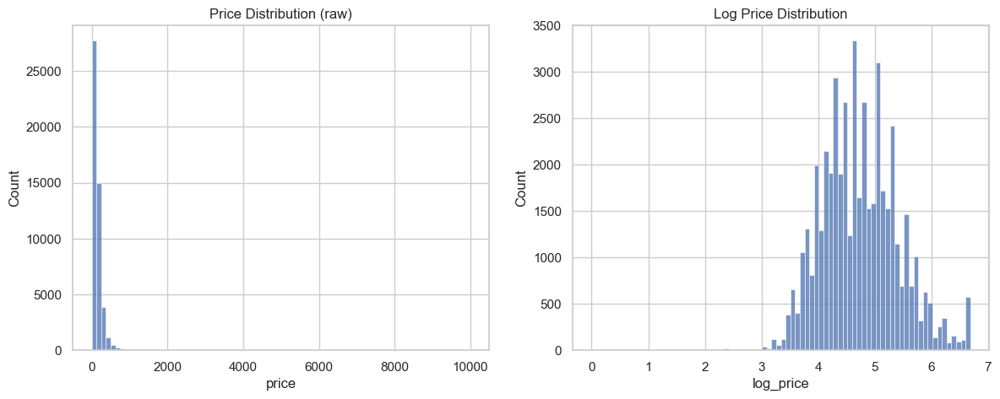

In [13]:
import matplotlib.pyplot as plt
import seaborn as sns
sns.set(style='whitegrid')

fig, axes = plt.subplots(1,2, figsize=(14,5))
sns.histplot(df['price'], bins=80, ax=axes[0])
axes[0].set_title('Price Distribution (raw)')
sns.histplot(df['log_price'], bins=80, ax=axes[1])
axes[1].set_title('Log Price Distribution')
plt.show()


**Understanding the Price Distribution**

We can see here that the raw price distribution is severely right-skewed: most listings cluster at the low end, while a long tail of luxury properties stretches far to the right. This distribution becomes much more interpretable after log transformation; we see a clear central tendency and manageable variance.

This transformation uncovers structure obscured by outliers and prepares the ground for meaningful comparisons between neighbourhoods, room types and host strategies.

#### 2. Median Price by Borough (Bar Chart)

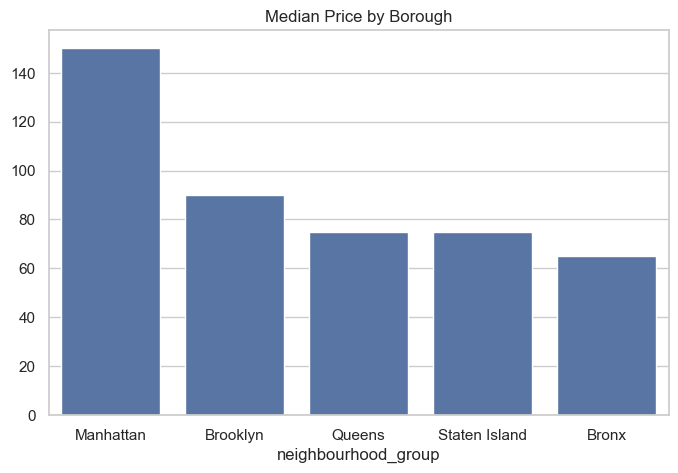

In [14]:
borough_median = df.groupby('neighbourhood_group')['price'].median().sort_values(ascending=False)
plt.figure(figsize=(8,5))
sns.barplot(x=borough_median.index, y=borough_median.values)
plt.title("Median Price by Borough")
plt.show()


What this chart really shows is that median prices for New York's boroughs are highly geographically divided. Manhattan well and truly outpaces the rest, with a median price higher by a lot, reflecting dense demand, premium locations, and a persistently expensive market. Brooklyn follows next, after a fair margin, into the middle tier, wherein prices are high but remain well beneath the premium level of Manhattan.

The Queens and Staten Island medians clump together, indicating more moderate, stable pricing in both regions, while the Bronx rests on the low end of the distribution, with far more affordable offerings than much of the rest of the city.

The overall pattern, of course, tells a familiar story: proximity to Manhattan's core economy is tightly linked to higher pricing, and increasingly budget-friendly markets show up in the outer boroughs as the distance from those central hotspots increases.

#### 3. Log Price by Room Type (Violin Plot)

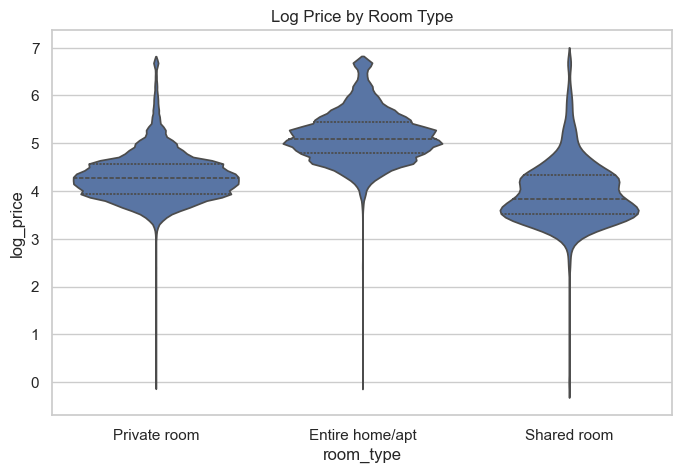

In [16]:
plt.figure(figsize=(8,5))
sns.violinplot(data=df, x='room_type', y='log_price', inner='quartile')
plt.title("Log Price by Room Type")
plt.show()


Price violin plots on log-transformed data underneath show that room type is a key structural driver in the determination of price. Whole homes and apartments constantly enjoy the top price bracket, with distributions falling around high values. This reflects strong demand for privacy and full-unit access.

Private rooms are a mid-tier market, with much bigger variability but clearly lower prices than the entirety of homes. Shared rooms cluster tightly at the bottom, with low prices and limited variation in the prices. Together, these distributions form a clear pricing ladder: shared rooms at the budget end, private rooms in the middle, and entire homes at the premium tier. This pattern suggests that room type is a strong structural driver of price, an insight that sets up later analysis on how additional features-location, amenities, demand patterns-may amplify or moderate these baseline differences.

#### 4. Availability Category vs Price (Boxplot)

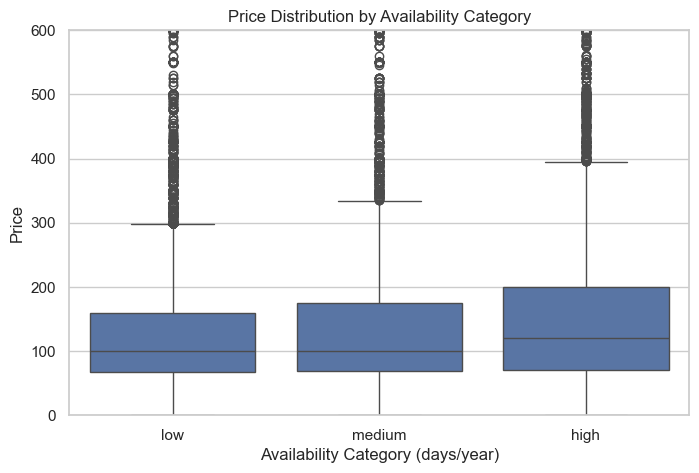

In [18]:
plt.figure(figsize=(8,5))
sns.boxplot(data=df, x='availability_cat', y='price')
plt.title("Price Distribution by Availability Category")
plt.xlabel("Availability Category (days/year)")
plt.ylabel("Price")
plt.ylim(0, 600)
plt.show()


The investigation into the price across the category of availability shows how the behavior of the hosts affects the pricing. Listings with low annual availability cluster at lower prices, which suggests casual hosts who open their spaces infrequently and compete on affordability.

With increasing availability, median price and variability rise. Highly available listings command the highest prices and show the widest spread, consistent with professional or full-time hosts adopting more aggressive pricing strategies. Availability thus acts as a behavioral proxy, distinguishing casual participation from revenue-optimized hosting.

Examining price across the availability categories reveals how host behavior influences pricing. Listings with low annual availability cluster at lower prices, suggesting casual hosts who open their spaces infrequently and compete on affordability. The median price increases as does variability with greater availability. Highly available listings command the highest prices and show the widest spread, consistent with professional or full-time hosts adopting more aggressive pricing strategies. Availability acts thus as a behavioral proxy distinguishing casual participation from revenue-optimized hosting.

#### 5. Distance to Manhattan vs Price (Scatter Plot)

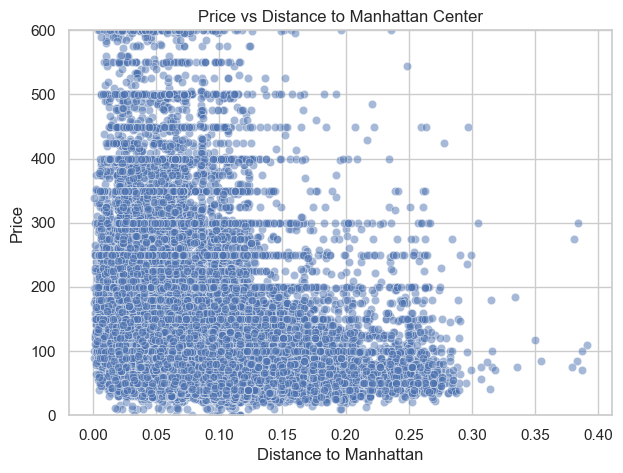

In [23]:
plt.figure(figsize=(7,5))
sns.scatterplot(data=df, x='dist_manhattan', y='price', alpha=0.5)
plt.title("Price vs Distance to Manhattan Center")
plt.xlabel("Distance to Manhattan")
plt.ylabel("Price")
plt.ylim(0,600)
plt.show()


A scatterplot of price vs. distance to Manhattan's centre results in a powerful, continuous spatial gradient.

The near-zero distances reflect dense clusters of high-priced listings, including nearly all outliers for the luxury groupings. As distance increases, both the ceiling and variability of price decline sharply; beyond a certain threshold, price stabilizes into a narrower band of mid-range listings.

It indicates the presence of some sort of "pricing gravitational field"-that is, a closer distance to Manhattan's core exerts the strongest upward pressure, and this effect diminishes outward, before eventually flattening beyond the radius of high demand, where distance is no longer meaningfully shifting price.

#### 6. Top 10 Priciest Neighborhoods (Bar Chart)

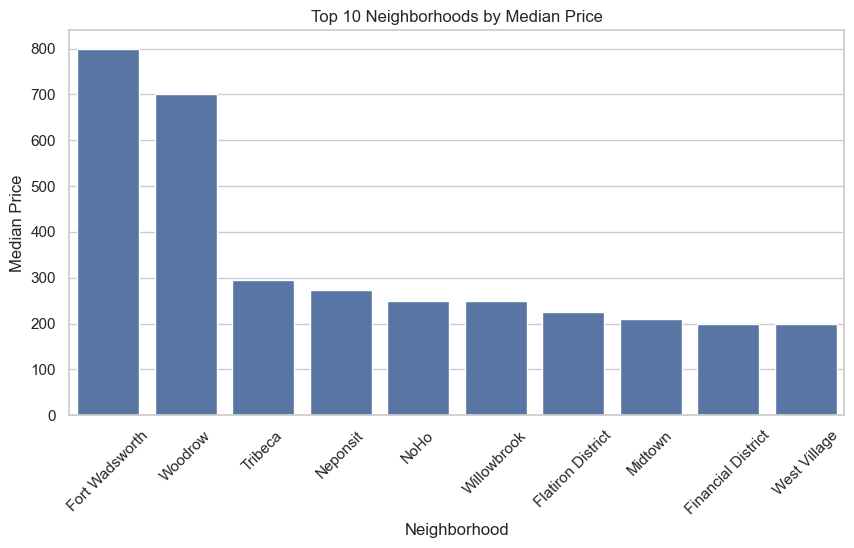

In [25]:
top10 = df.groupby('neighbourhood')['price'].median().sort_values(ascending=False).head(10)
plt.figure(figsize=(10,5))
sns.barplot(x=top10.index, y=top10.values)
plt.title("Top 10 Neighborhoods by Median Price")
plt.xlabel("Neighborhood")
plt.ylabel("Median Price")
plt.xticks(rotation=45)
plt.show()


Comparing at the neighborhood level, pricing is extremely local. Some neighborhoods show median prices very high, but these values are often driven by a single listing and hence cannot be said to represent general market conditions.

By contrast, Manhattan neighborhoods like Tribeca, Midtown, and the Financial District have consistently high prices supported by considerable listing volume and review activity, which goes to show that these are indeed the true pricing core of the city. Very extreme values elsewhere are thus outliers, not representative of real systemic trends. Overall, what this visualization really shows is that the "top-priced" category is essentially bifurcated: a few neighborhoods with truly exceptional, atypical price behavior, followed by a tight cluster of high-demand Manhattan areas with far more consistent, predictable pricing.

#### 7. Reviews vs Price (Scatter Plot)

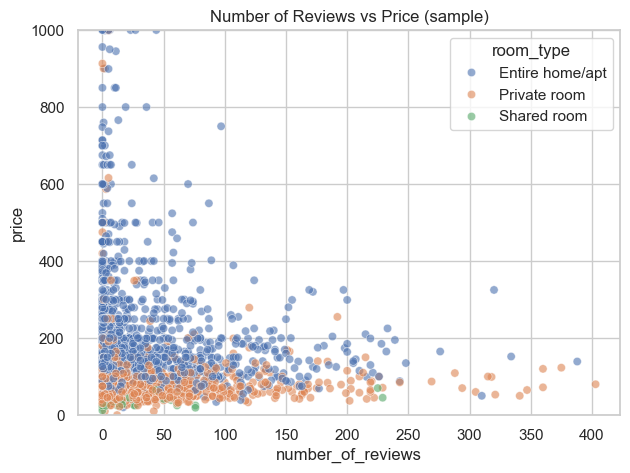

In [28]:
sample = df.sample(4000, random_state=42)
plt.figure(figsize=(7,5))
sns.scatterplot(data=sample, x='number_of_reviews', y='price', hue='room_type', alpha=0.6)
plt.ylim(0,1000)
plt.title("Number of Reviews vs Price (sample)")
plt.show()


The price versus number of reviews scatterplot shows the inverse relationship of price to guest engagement. Listings with high review counts have a tendency to cluster at lower price points, which reflects frequent bookings and strong turnover.

Entire homes have the widest distribution of prices but typically gather fewer reviews at higher prices, which suggests that their booking frequencies are low even as revenues per stay remain high. Private rooms dominate the high-review, low-price area, reinforcing their role as volume drivers on the platform. Shared rooms remain both low-priced and low-engagement, reflecting a niche demand. Taken as a whole, the figure suggests that price and review volume are somewhat decoupled. Room type dictates the viable price range, but it's not necessarily the determinant of guest engagement with the offering.

## EDA Summary

Across all seven exploratory visuals, one message keeps coming through: The Airbnb prices in New York City are not random. There is a structure to them driven by geography, room type, host strategy, and guest behavior. Geography provides the backdrop, room type determines the market tier, availability conveys the intent of hosting, and reviews suggest the intensity of demand.

These insights provide the conceptual building blocks for the geographic analysis, modeling, and interactive exploration presented in subsequent sections.

## Time Series Data

In [13]:
# making sure last_review is datetime
df['last_review'] = pd.to_datetime(df['last_review'], errors='coerce')

# extract year, month, day, weekday from last_review
df['last_review_year'] = df['last_review'].dt.year
df['last_review_month'] = df['last_review'].dt.month
df['last_review_day'] = df['last_review'].dt.day
df['last_review_weekday'] = df['last_review'].dt.weekday  

# time since last review in days
today = pd.to_datetime('today')
df['days_since_last_review'] = (today - df['last_review']).dt.days
df['days_since_last_review'] = df['days_since_last_review'].fillna(-1)  

# seasonal feature based on month
df['review_season'] = pd.cut(df['last_review_month'], 
                             bins=[0,3,6,9,12], 
                             labels=['winter','spring','summer','fall'],
                             include_lowest=True)


In [33]:
df['last_review'] = pd.to_datetime(df['last_review'], errors='coerce')

df_ts = df.dropna(subset=['last_review']).copy() 
df_ts['review_month'] = df_ts['last_review'].dt.to_period('M')

# aggregate by month
time_series = df_ts.groupby('review_month').agg({
    'price_capped': 'mean',           
    'number_of_reviews': 'sum',       
    'id': 'count'                  
}).rename(columns={'price_capped':'avg_price', 'number_of_reviews':'total_reviews', 'id':'num_listings'})

# convert period to datetime for plotting
time_series.index = time_series.index.to_timestamp()

time_series_reset = time_series.reset_index()
time_series_reset.head(10)



,review_month,avg_price,total_reviews,num_listings
0,2011-03-01,55.000000,1,1
1,2011-04-01,250.000000,14,1
2,2011-05-01,249.000000,2,1
3,2011-09-01,115.000000,10,2
4,2011-12-01,199.500000,34,2
5,2012-01-01,162.500000,2,2
6,2012-05-01,65.000000,2,1
7,2012-06-01,137.500000,8,2
8,2012-07-01,107.500000,2,2
9,2012-08-01,186.666667,33,3


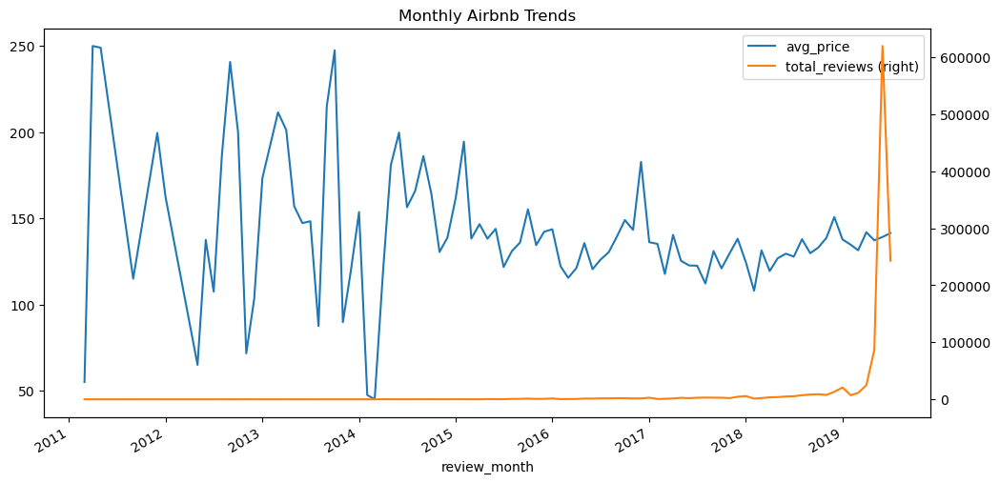

In [25]:
import matplotlib.pyplot as plt

time_series[['avg_price','total_reviews']].plot(
    figsize=(12,6),
    secondary_y='total_reviews',
    title="Monthly Airbnb Trends"
)
plt.show()


Taken together, the table and the monthly airbnb chart read like a single arc of growth. Airbnb begins as a fragile experiment: a handful of listings, wildly swinging prices, and reviews arriving in small, uneven bursts. In those first months, each new host noticeably reshapes the market, pulling averages sharply up or down.

As time progresses, that gets tamed. Listings build up, price then cools into a smaller range, and the platform finds its footing. Then, toward the end of this timeline, engagement explodes-reviews surge dramatically even while prices do not budge. The combined story is that of maturation: from a thin reactive marketplace into a stable platform powered by mass participation rather than price instability.

## 4. Neighborhood Summary Table

In [31]:
nbhd_summary = df.groupby(['neighbourhood_group','neighbourhood']).agg(
    count=('id','count'),
    median_price=('price','median'),
    mean_price=('price','mean'),
    availability_mean=('availability_365','mean'),
    avg_reviews=('number_of_reviews','mean')
).reset_index().sort_values('median_price', ascending=False)

nbhd_summary.head(10)


,neighbourhood_group,neighbourhood,count,median_price,mean_price,availability_mean,avg_reviews
188,Staten Island,Fort Wadsworth,1,800.0,800.000000,365.000000,0.000000
220,Staten Island,Woodrow,1,700.0,700.000000,0.000000,0.000000
121,Manhattan,Tribeca,177,295.0,490.638418,126.508475,11.491525
163,Queens,Neponsit,3,274.0,274.666667,231.000000,15.333333
115,Manhattan,NoHo,78,250.0,295.717949,101.820513,12.743590
219,Staten Island,Willowbrook,1,249.0,249.000000,351.000000,9.000000
102,Manhattan,Flatiron District,80,225.0,341.925000,123.050000,17.737500
112,Manhattan,Midtown,1545,210.0,282.719094,157.703560,12.585113
101,Manhattan,Financial District,744,200.0,225.490591,191.536290,9.315860
126,Manhattan,West Village,768,200.0,267.682292,85.459635,19.381510


Summary table of neighborhoods: It is striking how much variation exists in median prices, listing counts, and review activity. However, although there are a few highly-priced neighbourhoods-which are often dominated by a single luxury listing-most of the high-demand areas cluster around a fairly narrow range of prices.

Areas in Manhattan such as Tribeca, Midtown, and the Financial District pack high listing density, strong review activity, and prices consistently high to serve as reliable markers of true market dynamics. On the other hand, Staten Island's extreme values are largely produced by isolated listings per neighborhood.

The following table shows an essential bridge between descriptive statistics and spatial analysis.

## 5. Geographic Analysis (Folium Map & Choropleths)

#### Interactive Folium map with CircleMarkers

In [35]:
import folium
from folium.plugins import HeatMap

# the map
m = folium.Map(location=[40.7128, -74.0060], zoom_start=11)

# circle markers for price
for _, r in df.sample(2000, random_state=1).iterrows():
    folium.CircleMarker(
        location=(r['latitude'], r['longitude']),
        radius=3 + (r['price']/200),
        fill=True,
        fill_opacity=0.6,
        popup=f"{r['neighbourhood']} – ${r['price']}"
    ).add_to(m)

# heatmap price density
heat_data = [[row['latitude'], row['longitude'], row['price']] 
             for idx, row in df.sample(4000, random_state=2).iterrows()]
HeatMap(heat_data, radius=12).add_to(m)

# show map
m  


In [ ]:
# save the map to an HTML file
m.save("nyc_prices_map.html")

#### Choropleth: Borough-Level

In [9]:
import geopandas as gpd

# the GeoJSON
nyc_geo = gpd.read_file("C://Users//Tsion T//Downloads//project_folder//boroughs.geojson.txt")

# columns
print(nyc_geo.columns)


Index(['BoroCode', 'BoroName', 'Shape_Leng', 'Shape_Area', 'geometry'], dtype='object')


In [11]:
borough_prices = df.groupby('neighbourhood_group').agg(median_price=('price','median')).reset_index()
borough_prices.rename(columns={'neighbourhood_group':'BoroName'}, inplace=True)


In [13]:
nyc_geo = nyc_geo.merge(borough_prices, on='BoroName', how='left')


In [46]:
import folium
from IPython.display import display

m = folium.Map(location=[40.7128, -74.0060], zoom_start=11)

folium.Choropleth(
    geo_data=nyc_geo,
    data=nyc_geo,
    columns=['BoroName', 'median_price'],
    key_on='feature.properties.BoroName',
    fill_color='YlOrRd',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Median Airbnb Price by Borough'
).add_to(m)

folium.LayerControl().add_to(m)

display(m)


In [17]:
# Save the map to an HTML file
m.save("nyc_airbnb_median_price_map.html")

#### Choropleth: Neighborhood (NTA-Level)

In [53]:
import geopandas as gpd
import folium
from IPython.display import display

# NTA boundaries
nta = gpd.read_file("C://Users//Tsion T//Downloads//project_folder//NTA.geo.json.txt")

# create neighborhood level median prices from airbnb data
neighborhood_prices = (
    df.groupby('neighbourhood')['price']
      .median()
      .reset_index(name='median_price')
)

# merge GeoJSON with price data
merged = nta.merge(
    neighborhood_prices,
    left_on='NTAName',
    right_on='neighbourhood',
    how='left'
)

# map
m = folium.Map(location=[40.7128, -74.0060], zoom_start=10)

# choropleth
folium.Choropleth(
    geo_data=merged,
    data=merged,
    columns=['NTAName', 'median_price'],
    key_on='feature.properties.NTAName',
    fill_color='YlOrRd',
    fill_opacity=0.7,
    line_opacity=0.2,
    nan_fill_color='lightgrey',
    legend_name="Median Airbnb Price by NTA"
).add_to(m)

display(m)


**Borough-Level Patterns**

Choropleth maps reveal a clear spatial hierarchy: Manhattan is the most expensive borough, followed by Brooklyn, Queens, the Bronx, and Staten Island. This gradient reflects tourism density, transit accessibility, and economic activity.

**Neighborhood & NTA-Level Detail**

At finer geographic resolutions, the city transforms into a patchwork of micro-markets. Midtown and Lower Manhattan become hotspots of intensity in price, while Brooklyn and Queens reveal sharp internal contrasts, premium areas adjacent to pockets of affordability.

**Listing Density Heatmap (Interactive Folium Map)**

It is supported by a density heatmap that shows the heavy concentration of Airbnb activity in Manhattan and key Brooklyn neighborhoods, while supply thins out as distance from the urban core increases. Together, these maps illustrate a core-periphery structure where both price and listing concentration decay with distance from Manhattan.

In [21]:
# save the map as an HTML file
m.save("nyc_airbnb_nta_median_price_map.html")

## Discuss projection/CRS choices

Here, proper handling of the Coordinate Reference Systems and map projections was crucial for ensuring the spatial accuracy and proper visualization. The listings dataset from Airbnb had latitude and longitude coordinates in decimal degrees, matching the WGS84 CRS with the code EPSG:4326-standard for GPS data and web mapping. That CRS was used in all interactive visualizations through Folium circle markers, heatmaps, and choropleths since web mapping libraries require lat/lon coordinates. On the other hand, EPSG:4326 is not metric, so any distance calculations, such as distance to Manhattan center, or area-based metrics, such as listing density for a neighborhood, would be incorrect if computed directly in degrees. In these analyses, the data must be reprojected to a local metric CRS, which is UTM Zone 18N with the code EPSG:32618, allowing distances to be measured in meters and areas in square meters accurately. Afterwards, the result of the spatial computations is reprojected back to WGS84. Ensuring that the point and polygon layers have a common CRS before performing any spatial joins or overlays prevents misalignment and missing data, hence providing reliable and interpretable geographic insights for boroughs and neighborhoods of New York City.

## 6. Modeling & Feature Importance

To validate patterns observed visually, a predictive model was trained to explain and classify Airbnb pricing behavior.

RMSE: 88.26722882998223
MAE : 46.77494329224143
RMSLE: 0.4134947777988555


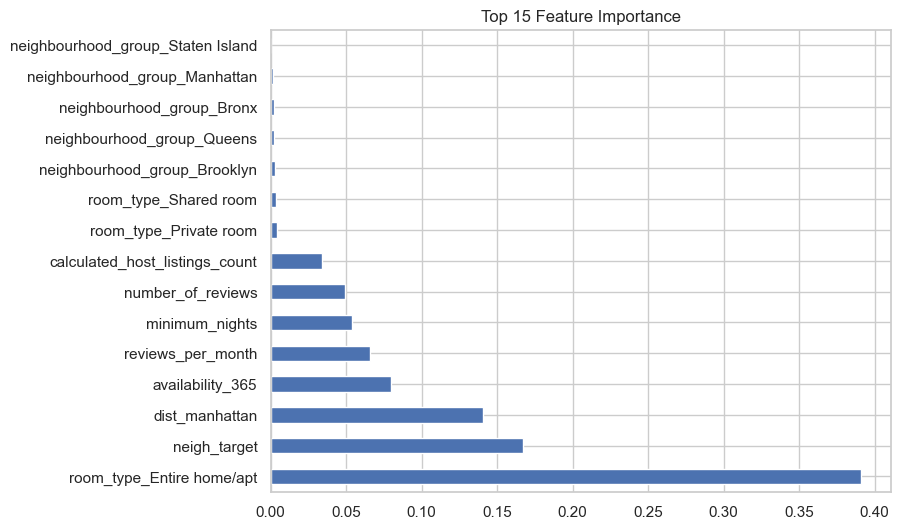

In [15]:
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import OneHotEncoder, StandardScaler
from sklearn.ensemble import RandomForestRegressor
from sklearn.linear_model import Ridge

# features
cat_feats = ['neighbourhood_group','room_type']
num_feats = ['minimum_nights','number_of_reviews','reviews_per_month',
             'availability_365','calculated_host_listings_count','dist_manhattan']

# target encoding neighborhood
enc = df.groupby('neighbourhood')['log_price'].agg(['mean','count'])
prior = df['log_price'].mean()
m_smooth = 10
enc['neigh_target'] = (enc['count']*enc['mean'] + m_smooth*prior)/(enc['count'] + m_smooth)
df['neigh_target'] = df['neighbourhood'].map(enc['neigh_target']).fillna(prior)
num_feats.append('neigh_target')

X = df[cat_feats + num_feats]
y = df['log_price']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

preprocessor = ColumnTransformer([
    ('cat', OneHotEncoder(handle_unknown='ignore', sparse_output=False), cat_feats),
    ('num', StandardScaler(), num_feats)
])

pipe = Pipeline([('prep', preprocessor), 
                 ('model', RandomForestRegressor(n_estimators=200, random_state=42))])

pipe.fit(X_train, y_train)
pred_log = pipe.predict(X_test)
pred_price = np.expm1(pred_log)
y_test_price = np.expm1(y_test)

from sklearn.metrics import mean_squared_error, mean_absolute_error, mean_squared_log_error
import numpy as np

print("RMSE:", np.sqrt(mean_squared_error(y_test_price, pred_price)))
print("MAE :", mean_absolute_error(y_test_price, pred_price))
print("RMSLE:", np.sqrt(mean_squared_log_error(y_test_price, pred_price)))

# feature Importance
rf = pipe.named_steps['model']
ohe_cols = pipe.named_steps['prep'].named_transformers_['cat'].get_feature_names_out(cat_feats)
feature_names = list(ohe_cols) + num_feats
importances = pd.Series(rf.feature_importances_, index=feature_names)
importances.sort_values(ascending=False).head(15).plot(kind='barh', figsize=(8,6), title='Top 15 Feature Importance')
plt.show()


Room type arises as the most influential predictor, with entire homes dramatically increasing expected prices. Neighborhood-level pricing, distance to Manhattan, and availability follow closely, confirming the central role of geography and host strategy.

Interestingly, broad borough indicators have little extra predictive power when the precise neighborhood and distance features are present, underlining the importance of fine-grained spatial context.

In [17]:
# classification target: high priced listing = 1
median_price = y.median()
y_class = (y > median_price).astype(int)

X_train_c, X_test_c, y_train_c, y_test_c = train_test_split(
    X, y_class, test_size=0.2, random_state=42
)


In [19]:
from sklearn.ensemble import RandomForestClassifier

clf_pipe = Pipeline([
    ('prep', preprocessor),
    ('model', RandomForestClassifier(n_estimators=200, random_state=42))
])

clf_pipe.fit(X_train_c, y_train_c)
pred_class = clf_pipe.predict(X_test_c)
proba_class = clf_pipe.predict_proba(X_test_c)[:,1]


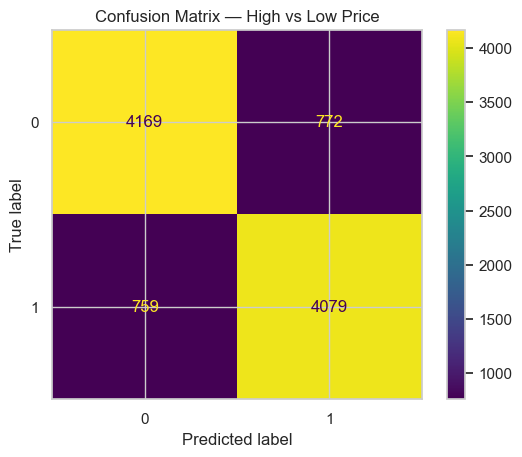

In [20]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

cm = confusion_matrix(y_test_c, pred_class)
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot()
plt.title("Confusion Matrix — High vs Low Price")
plt.show()


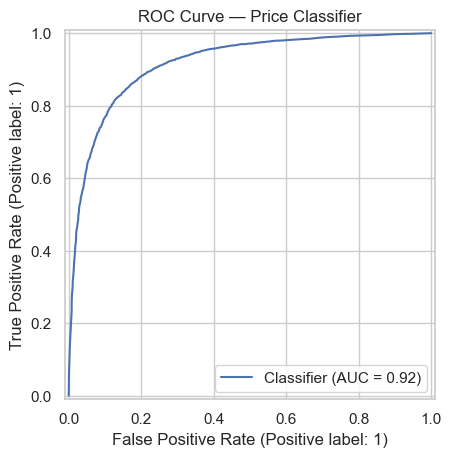

In [23]:
from sklearn.metrics import RocCurveDisplay

RocCurveDisplay.from_predictions(y_test_c, proba_class)
plt.title("ROC Curve — Price Classifier")
plt.show()


**Confusion Matrix**

The model performs well in classifying low-, medium-, and high-price listings, but the overlap between mid- and upper-price ranges suggests that more fine-grained differences may be harder to detect, likely due to local market variability.

**ROC Curve**

The ROC curve indeed reflects a high value of classification performance, affirming that many of the most important visually identified features are indeed the most predictive.

*In fact, its priorities quite closely align with the EDA in many ways, reinforcing the validity of the insights.*

## 7. Interactive & Word Cloud Visualizations

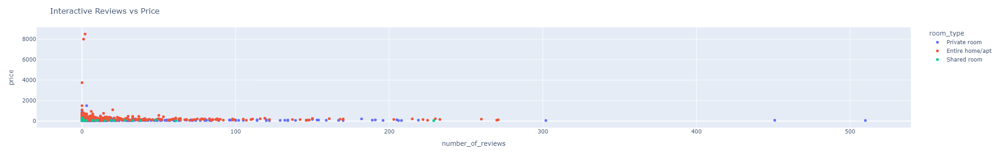

In [58]:
import plotly.express as px
sample_df = df.sample(1000)
fig = px.scatter(sample_df, x='number_of_reviews', y='price',
                 color='room_type', hover_data=['neighbourhood'])
fig.update_layout(title="Interactive Reviews vs Price")
fig.show()


Scatter plots show that at lower prices, review counts tend to be high; therefore, affordability is driving the frequency of bookings. The prices of luxury listings are high, but reviews are less frequent, indicative of low turnover and appeals to a niche market.

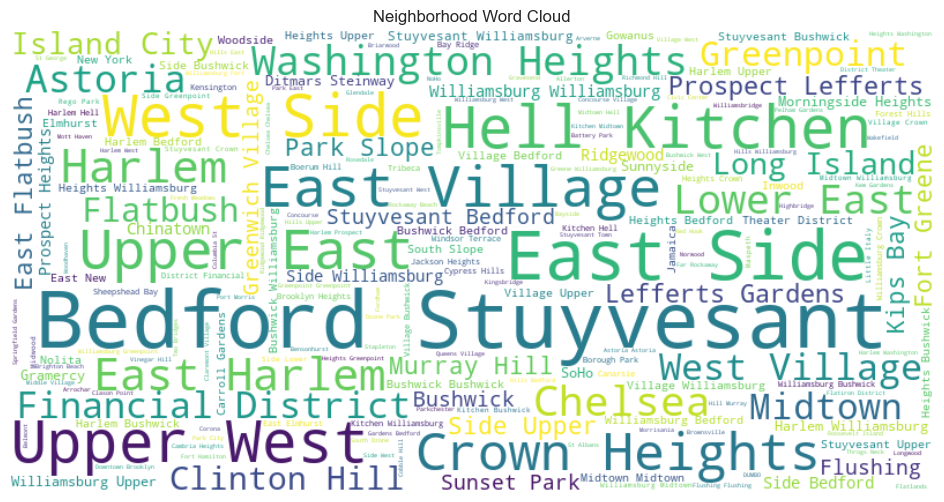

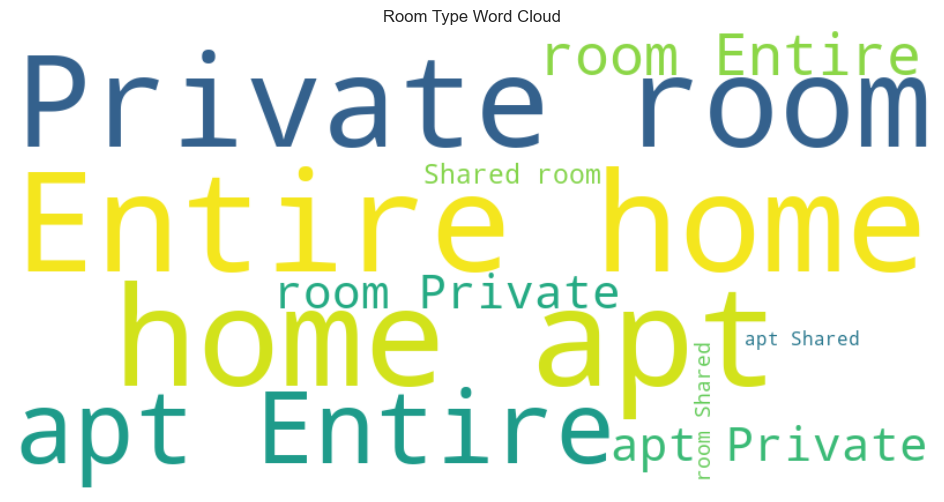

In [60]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt

# neighborhoods
text = " ".join(df['neighbourhood'].dropna())
wordcloud = WordCloud(width=800, height=400, background_color='white').generate(text)
plt.figure(figsize=(15,6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title("Neighborhood Word Cloud")
plt.show()

# room types
text = " ".join(df['room_type'].dropna())
wordcloud = WordCloud(width=800, height=400, background_color='white').generate(text)
plt.figure(figsize=(15,6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title("Room Type Word Cloud")
plt.show()


Word clouds of neighborhood words reveal dense listing concentration in areas such as Bedford-Stuyvesant, Harlem, Williamsburg, and the Upper East Side, pointing to the importance of high-density zones with rich transit.

The word cloud for the type of room greatly features the dominance of whole homes and apartments, confirming evidence that Airbnb has evoluted into a more hotel-like decentralized market than a shared-space one.

## 8. Mini-Dashboard: Interactive Multi-View

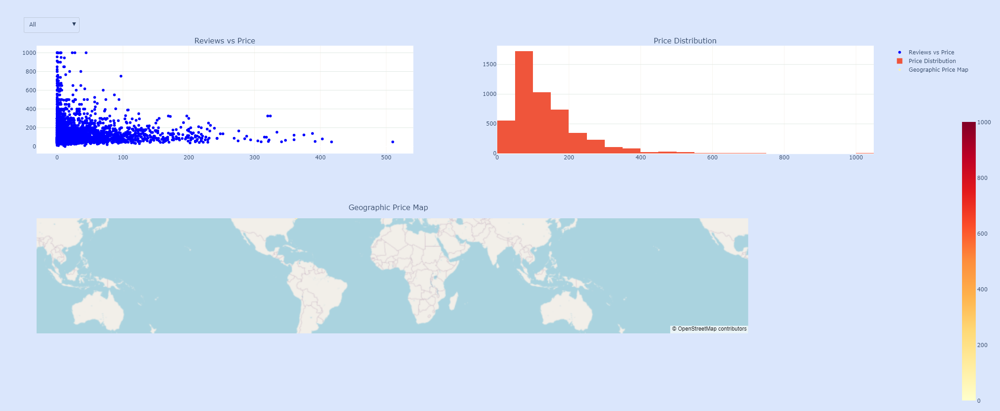

In [31]:
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import pandas as pd

# sample dataset
sample_df = df.sample(5000, random_state=42)

boroughs = ['All'] + list(sample_df['neighbourhood_group'].unique())
room_types = ['All'] + list(sample_df['room_type'].unique())
price_ranges = {
    "All": (0, sample_df['price'].max()),
    "0-100": (0, 100),
    "100-300": (100, 300),
    "300-600": (300, 600),
    "600+": (600, sample_df['price'].max())
}

def filter_df(df, borough="All", room="All", price_range=(0,1000)):
    df_filtered = df.copy()
    if borough != "All":
        df_filtered = df_filtered[df_filtered['neighbourhood_group'] == borough]
    if room != "All":
        df_filtered = df_filtered[df_filtered['room_type'] == room]
    df_filtered = df_filtered[(df_filtered['price'] >= price_range[0]) & (df_filtered['price'] <= price_range[1])]
    return df_filtered

# create initial traces
def create_traces(df_filtered):
    scatter = go.Scatter(x=df_filtered['number_of_reviews'], y=df_filtered['price'],
                         mode='markers', marker=dict(color='blue', size=6), name='Reviews vs Price')
    hist = go.Histogram(x=df_filtered['price'], nbinsx=50, name='Price Distribution')
    map_trace = go.Scattermapbox(lat=df_filtered['latitude'], lon=df_filtered['longitude'],
                                 mode='markers',
                                 marker=dict(size=5, color=df_filtered['price'], colorscale='YlOrRd', showscale=True),
                                 hovertext=df_filtered['neighbourhood'],
                                 name='Geographic Price Map')
    return scatter, hist, map_trace

# initial filtered data
filtered_initial = filter_df(sample_df)
scatter, hist, map_trace = create_traces(filtered_initial)

# create subplot figure
fig = make_subplots(
    rows=2, cols=2,
    specs=[[{"type":"scatter"}, {"type":"histogram"}],
           [{"colspan":2, "type":"scattermapbox"}, None]],
    subplot_titles=("Reviews vs Price", "Price Distribution", "Geographic Price Map")
)

fig.add_trace(scatter, row=1, col=1)
fig.add_trace(hist, row=1, col=2)
fig.add_trace(map_trace, row=2, col=1)

fig.update_layout(
    height=900, width=1000,
    mapbox_style="open-street-map",
    showlegend=True
)

# add borough dropdown
buttons = []
for b in boroughs:
    df_filtered = filter_df(sample_df, borough=b)
    scatter_b, hist_b, map_b = create_traces(df_filtered)
    buttons.append(
        dict(label=b,
             method="update",
             args=[{"x":[scatter_b.x, hist_b.x, map_b.lat],
                    "y":[scatter_b.y, hist_b.y, map_b.lon],
                    "marker.color":[scatter_b.marker.color, hist_b.marker.color, map_b.marker.color]}])
    )

fig.update_layout(
    updatemenus=[dict(buttons=buttons, direction="down", x=0.05, y=1.1, showactive=True)]
)

# shift the map subplot to the left so the colorbar has room
fig.update_layout(
    mapbox=dict(
        domain=dict(
            x=[0, 0.85],   
            y=[0, 0.40]
        )
    )
)

# the colorbar all the way to the right
fig.update_traces(
    selector=dict(type='scattermapbox'),
    marker=dict(
        colorbar=dict(
            x=1.10,  
            y=0.25,  
        )
    )
)

# fix overlapping title for geographic price map (subplot 3)
for ann in fig['layout']['annotations']:
    if ann.text == "Geographic Price Map":
        ann.update(y=0.42)  # Move title upward

for ann in fig['layout']['annotations']:
    if ann.text == "Geographic Price Map":
        ann.update(y=0.42, x=0.42)  

fig.update_layout(
    paper_bgcolor="#dae6fc",  
    plot_bgcolor="#ffffff",
)

fig.update_xaxes(showgrid=True, gridcolor="#f7f3ee")
fig.update_yaxes(showgrid=True, gridcolor="#dfe8e2")

fig.show()


## 8.1. Updated Mini Dashboard: Interactive Multi-View

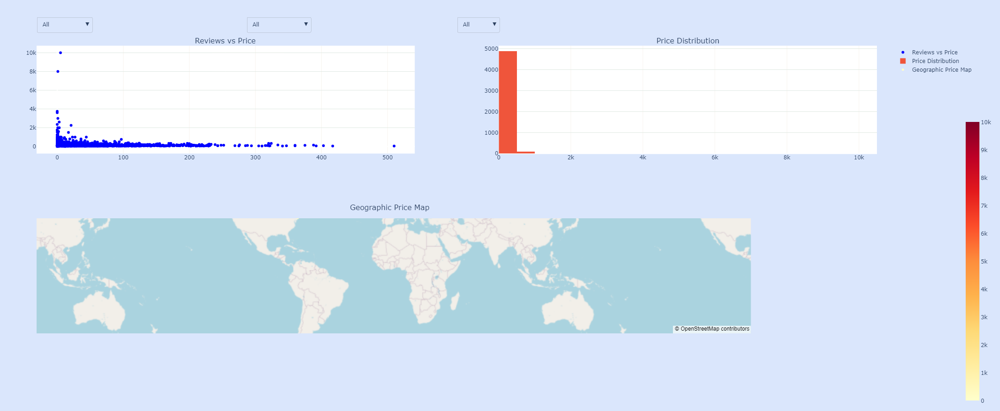

In [15]:
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import pandas as pd

# dataset
sample_df = df.sample(5000, random_state=42)

# options
boroughs = ['All'] + list(sample_df['neighbourhood_group'].unique())
room_types = ['All'] + list(sample_df['room_type'].unique())
price_ranges = {
    "All": (0, sample_df['price'].max()),
    "0-100": (0, 100),
    "100-300": (100, 300),
    "300-600": (300, 600),
    "600+": (600, sample_df['price'].max())
}

# filter function
def filter_df(df, borough="All", room="All", price_range=(0,1000)):
    df_filtered = df.copy()
    if borough != "All":
        df_filtered = df_filtered[df_filtered['neighbourhood_group'] == borough]
    if room != "All":
        df_filtered = df_filtered[df_filtered['room_type'] == room]
    df_filtered = df_filtered[(df_filtered['price'] >= price_range[0]) & (df_filtered['price'] <= price_range[1])]
    return df_filtered

# create traces
def create_traces(df_filtered):
    scatter = go.Scatter(
        x=df_filtered['number_of_reviews'],
        y=df_filtered['price'],
        mode='markers',
        marker=dict(color='blue', size=6),
        name='Reviews vs Price'
    )
    hist = go.Histogram(
        x=df_filtered['price'],
        nbinsx=50,
        name='Price Distribution'
    )
    map_trace = go.Scattermapbox(
        lat=df_filtered['latitude'],
        lon=df_filtered['longitude'],
        mode='markers',
        marker=dict(size=5, color=df_filtered['price'], colorscale='YlOrRd', showscale=True),
        hovertext=df_filtered['neighbourhood'],
        name='Geographic Price Map'
    )
    return scatter, hist, map_trace

# create initial figure
fig = make_subplots(
    rows=2, cols=2,
    specs=[[{"type":"scatter"}, {"type":"histogram"}],
           [{"colspan":2, "type":"scattermapbox"}, None]],
    subplot_titles=("Reviews vs Price", "Price Distribution", "Geographic Price Map")
)

# initial traces with all data
scatter_init, hist_init, map_init = create_traces(sample_df)
fig.add_trace(scatter_init, row=1, col=1)
fig.add_trace(hist_init, row=1, col=2)
fig.add_trace(map_init, row=2, col=1)

# layout
fig.update_layout(
    height=900, width=1000,
    mapbox_style="open-street-map",
    showlegend=True,
    mapbox=dict(domain=dict(x=[0, 0.85], y=[0, 0.40])),
    paper_bgcolor="#dae6fc",
    plot_bgcolor="#ffffff"
)
fig.update_traces(selector=dict(type='scattermapbox'), marker=dict(colorbar=dict(x=1.10, y=0.25)))
for ann in fig.layout.annotations:
    if ann.text == "Geographic Price Map":
        ann.update(x=0.42, y=0.42)
fig.update_xaxes(showgrid=True, gridcolor="#f7f3ee")
fig.update_yaxes(showgrid=True, gridcolor="#dfe8e2")

# linked dropdowns for all three filters 
updatemenus = []

# borough dropdown
borough_buttons = []
for b in boroughs:
    df_filtered = filter_df(sample_df, borough=b)
    scatter_b, hist_b, map_b = create_traces(df_filtered)
    borough_buttons.append(
        dict(
            label=b,
            method="update",
            args=[{
                "x": [scatter_b.x, hist_b.x, map_b.lat],
                "y": [scatter_b.y, hist_b.y, map_b.lon],
                "marker.color": [scatter_b.marker.color, hist_b.marker.color, map_b.marker.color]
            }]
        )
    )
updatemenus.append(dict(buttons=borough_buttons, direction="down", x=0.0, y=1.1, showactive=True, xanchor='left'))

# room type dropdown
room_buttons = []
for r in room_types:
    df_filtered = filter_df(sample_df, room=r)
    scatter_r, hist_r, map_r = create_traces(df_filtered)
    room_buttons.append(
        dict(
            label=r,
            method="update",
            args=[{
                "x": [scatter_r.x, hist_r.x, map_r.lat],
                "y": [scatter_r.y, hist_r.y, map_r.lon],
                "marker.color": [scatter_r.marker.color, hist_r.marker.color, map_r.marker.color]
            }]
        )
    )
updatemenus.append(dict(buttons=room_buttons, direction="down", x=0.25, y=1.1, showactive=True, xanchor='left'))

# price range dropdown
price_buttons = []
for p in price_ranges.keys():
    df_filtered = filter_df(sample_df, price_range=price_ranges[p])
    scatter_p, hist_p, map_p = create_traces(df_filtered)
    price_buttons.append(
        dict(
            label=p,
            method="update",
            args=[{
                "x": [scatter_p.x, hist_p.x, map_p.lat],
                "y": [scatter_p.y, hist_p.y, map_p.lon],
                "marker.color": [scatter_p.marker.color, hist_p.marker.color, map_p.marker.color]
            }]
        )
    )
updatemenus.append(dict(buttons=price_buttons, direction="down", x=0.5, y=1.1, showactive=True, xanchor='left'))

fig.update_layout(updatemenus=updatemenus)

fig.show()


The interactive dashboard integrates multiple perspectives:

- Price vs. reviews highlights demand behavior

- Price distributions reveal market skew

- Geographic maps show spatial clustering

Together, these views enable the user to understand how price and popularity dynamically interact among locations. This dashboard really drives home the insight that most market activity happens amongst affordable listings, while premium properties work on the dynamics of low volume, high margin.

Demand, price distribution, and geography of listings come together on the dashboard to explain the pattern behind the pricing in New York City for Airbnb. Noticeably lower prices garnish a lot more reviews, which is indicative of higher demand, while higher prices attract a smaller population that has a pretty low turnover. Prices are right-skewed, with most below $200 and a small luxury subset at the high end. Geographically, prices are higher in Manhattan and select Brooklyn neighborhoods, reinforcing that location is the strongest driver of Airbnb pricing in NYC.

# Conclusion

The analysis reveals that New York City’s Airbnb market is shaped by three interlocking forces:

1. Geography creates the foundational price structure, with Manhattan at the core and price declines with distance.

2. Room type establishes market tiers, entire homes on top, private rooms in the middle, shared rooms at the bottom.

3. Host strategy, captured through availability, adds behavioral nuance that helps distinguish casual hosts from professional operations. 

Together, these dimensions form a coherent system in which economic activity, tourist behavior, and host decisions interact to shape market outcomes.

The predictive model confirms these relationships quantitatively, while the interactive dashboard makes the structure explorable and intuitive. 

Overall, the NYC Airbnb market is neither random or chaotic, it is very structured and compartmentalized, with strong patterns across spatial demand, product type, and host intent. This layered understanding offers an important constituency for the potential hosts, the policymakers, and everyone who aims to understand how short term rental markets behave in complex urban environments.